In [2]:
import numpy as np
import glob
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D 
import json
import os
import pytorch_lightning as pl
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
from torchvision.utils import make_grid 
from torchvision import models
from PIL import Image
from pytorch_lightning.callbacks import early_stopping, model_checkpoint, ProgressBar
from pl_bolts.models.self_supervised import Moco_v2, BYOL
from pl_bolts.transforms.dataset_normalizations import imagenet_normalization
import tqdm
from sklearn.decomposition import PCA
import gc
import tsnecuda

%matplotlib inline

# first we have to create a dataset that loads slide by slide

class Camelyon16PreprocesseSlidedDataset(torch.utils.data.Dataset):
    """
    Dataset of unlabelled patches
    """
    
    def __init__(self, csv_file, transforms=None):
        self.data = pd.read_csv(csv_file)
        self.data["slide"] = self.data["path"].str.split("/", expand=True)[1]
        groups = self.data.groupby("slide")
        self.slidenames = groups["slide"].unique()
        self.patchesByslide = list(groups.groups.values())
        self.transforms = transforms
        
    def __len__(self):
        return len(self.patchesByslide)

    def __getitem__(self, idx):
        patches = self.data.iloc[self.patchesByslide[idx]]

#         ids = np.arange(0, len(patches))
#         np.random.shuffle(ids)
#         patches = patches.iloc[ids]

        imgs = []
        for path in patches["path"]:
            with Image.open(path) as img:
                imgs.append(np.asarray(img)[:, :, :3])

        global_label = patches["global_class"].iloc[0]
        local_labels = patches["local_class"].to_numpy()
        
        imgs = self.transforms(imgs)
        
        return imgs, (global_label, local_labels)
from sklearn.manifold import TSNE

In [7]:
from sklearn.manifold import TSNE
def visualize(filename):

    with np.load(filename, "r") as data:
        imgs = data["imgs"]
        local_labels = data["labels"]

    pca = PCA(30)
    pca.fit(imgs)
    plt.figure(figsize=(20, 10))
    plt.subplot(121)

    plt.bar(np.arange(len(pca.singular_values_)), pca.singular_values_)
    plt.title("Eigen values sorted largest to smallest")

    transformed = pca.transform(imgs)
#     x = transformed[:, 0]
#     y = transformed[:, 1]
#     radius = np.sqrt( x * x + y * y )
#     # Calculating angle (theta) in radian
#     theta = np.arctan(y/x)
#     # Converting theta from radian to degree
#     theta = 180 * theta/np.pi
    tsne = TSNE(n_components=2, n_iter=1000, learning_rate=270)
#     transformed = TSNE(perplexity=64.0, learning_rate=270).fit_transform(transformed)
    transformed = tsne.fit_transform(transformed)
    # calculate inra cluster variance
    cluster1 = imgs[local_labels==0]
    cluster2 = imgs[local_labels==1]
    
    cluster1_mean = cluster1.mean(0)
    cluster2_mean = cluster2.mean(0)
    global_mean = imgs.mean(0)
    
    wcss = np.sum((cluster1 - cluster1_mean)**2) + np.sum((cluster2 - cluster2_mean)**2)
    bcss = np.sum((cluster1 - global_mean)**2) + np.sum((cluster2 - global_mean)**2)

    ax = plt.subplot(122)
#     ax = plt.axes(projection="3d")
    ax.set_title(f"{filename}, BCSS {bcss:.2E}, WCSS {wcss:.2E}")
    ax.scatter(transformed[:, 0], transformed[:, 1], c=1-local_labels, alpha=0.4, cmap=plt.cm.Set1)
#     ax.scatter(theta[local_labels!=1], radius[local_labels!=1], s=15)
#     ax.scatter(theta[local_labels==1], radius[local_labels==1], s=15)
    plt.show()

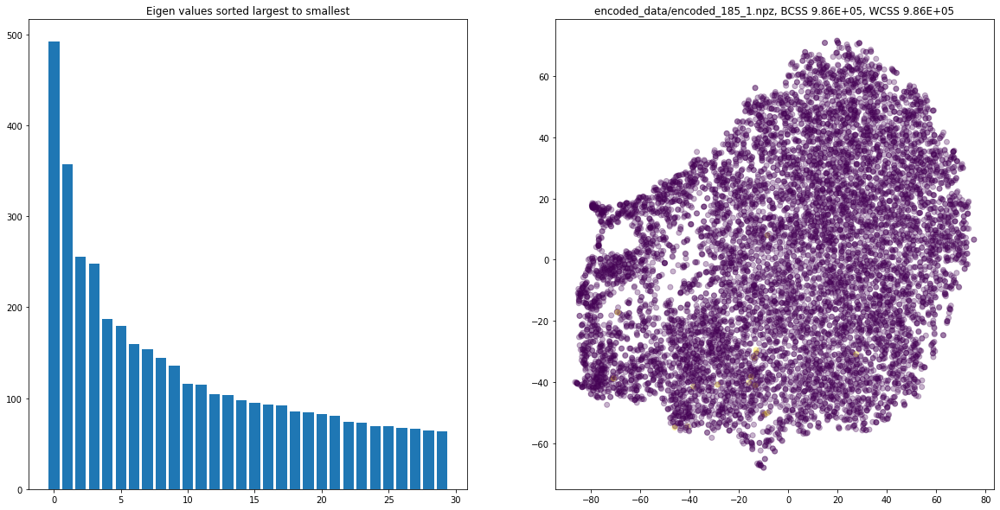

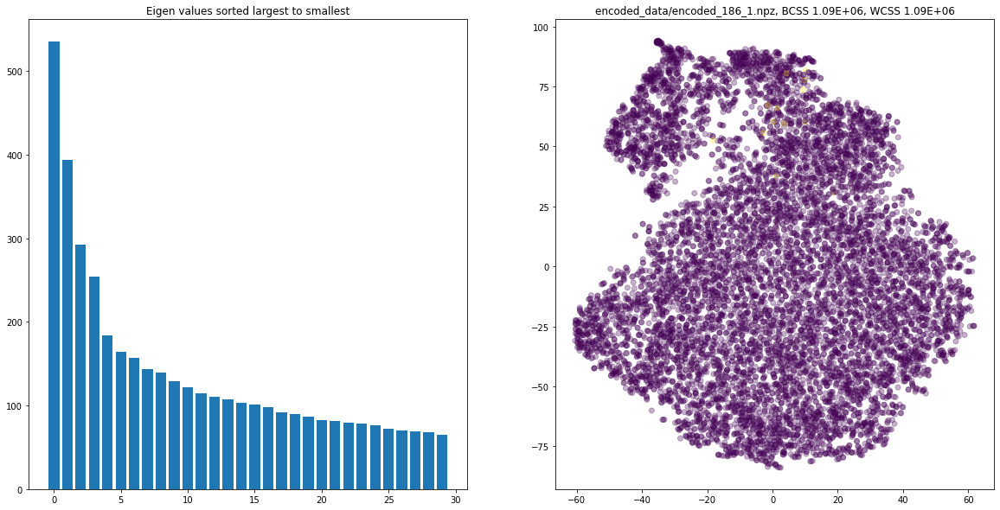

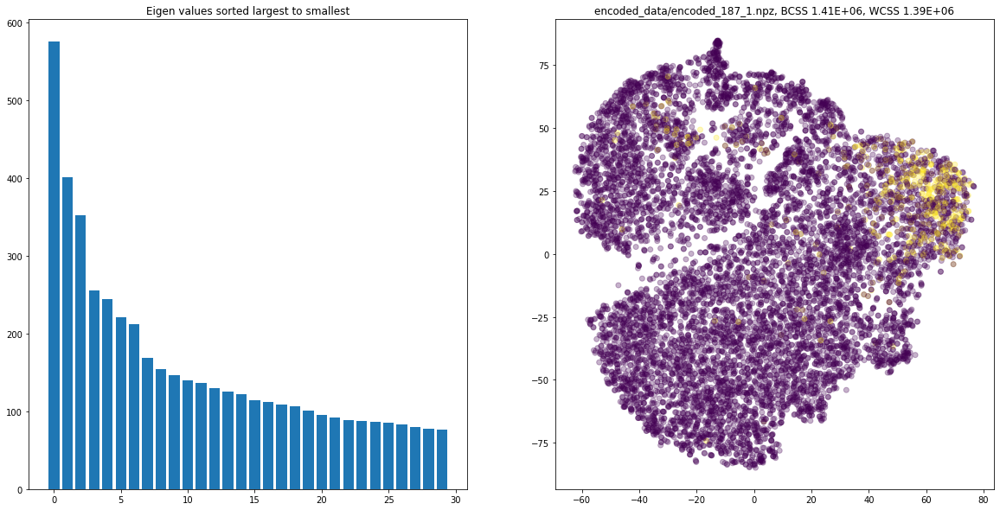

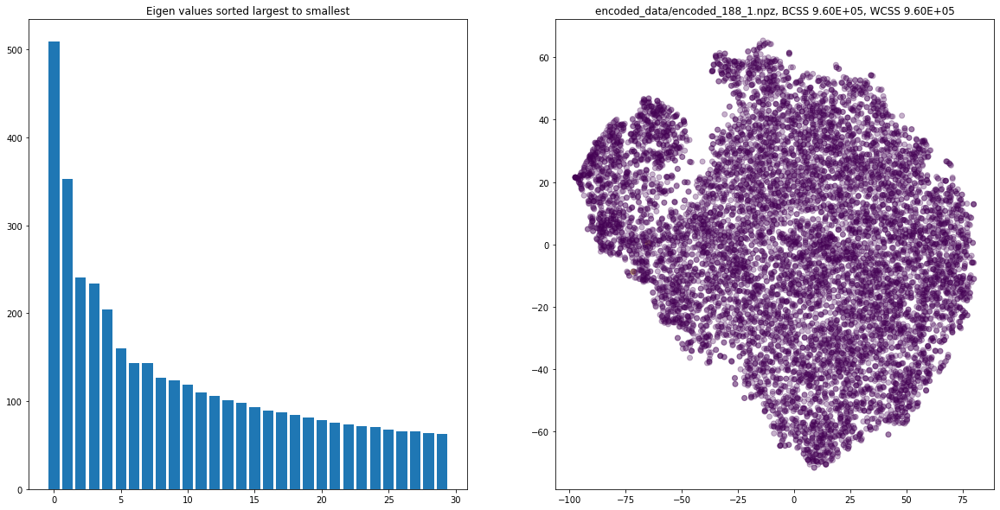

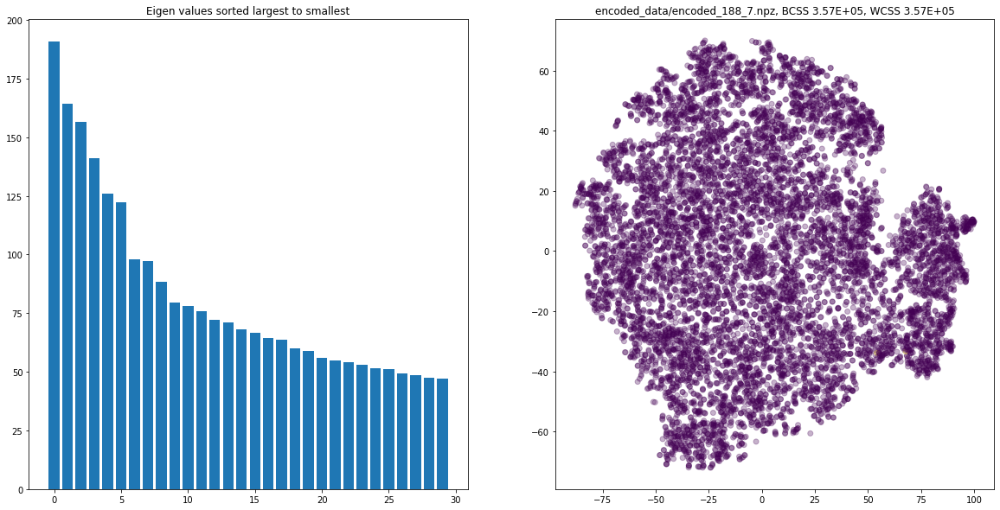

...

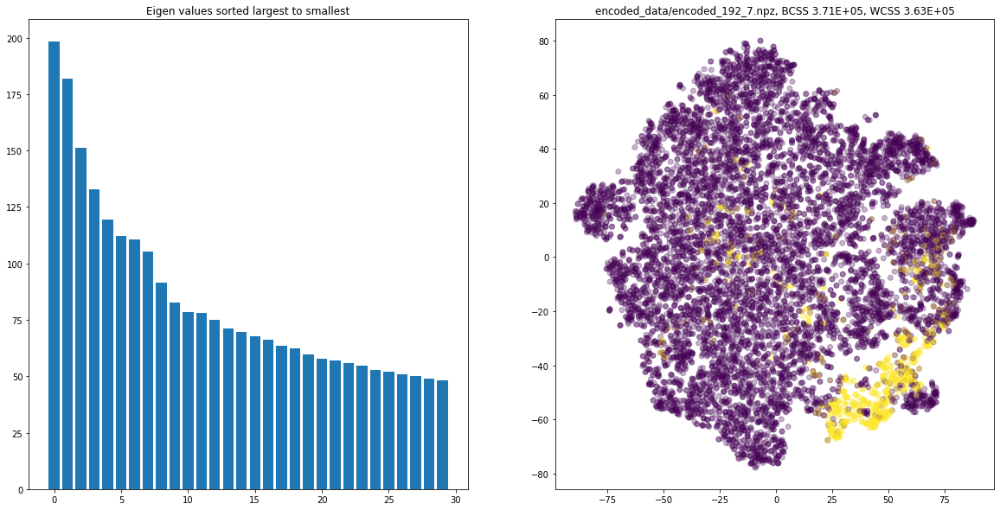

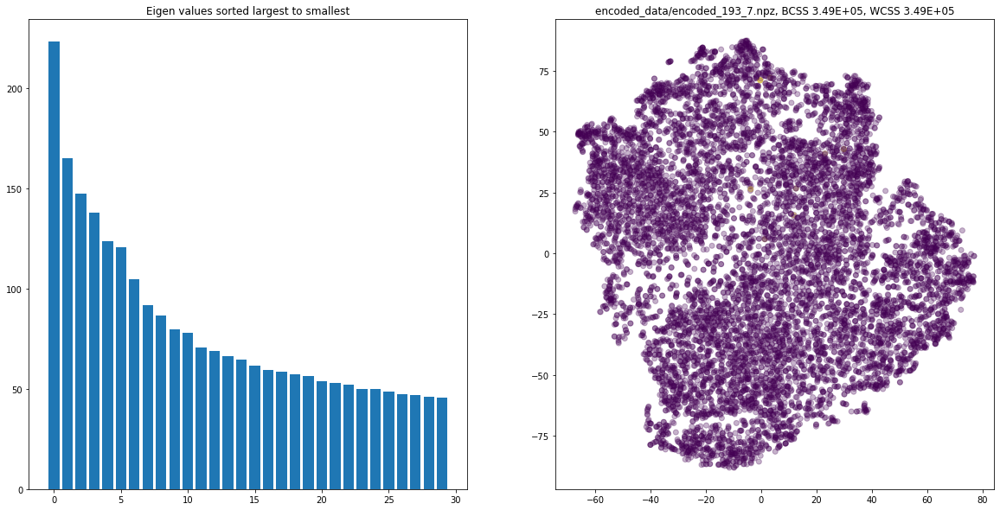

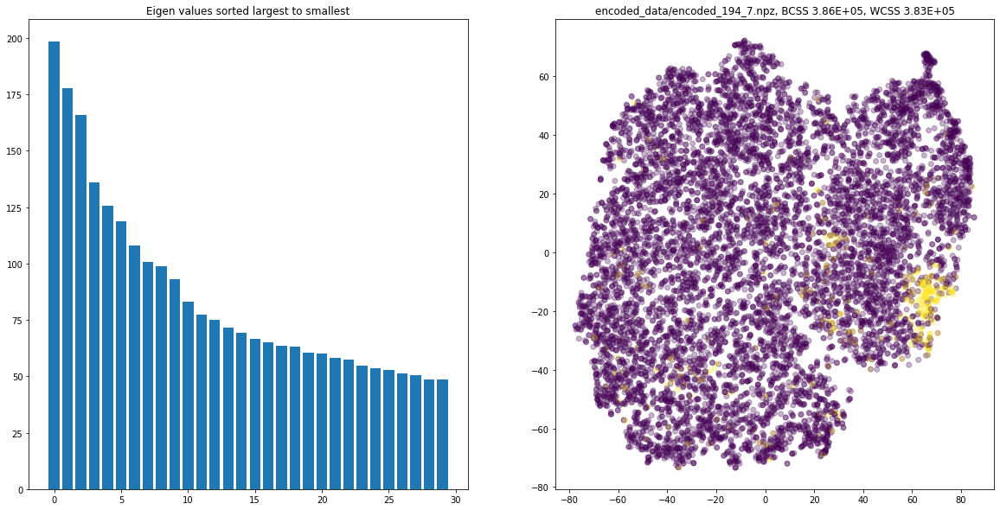

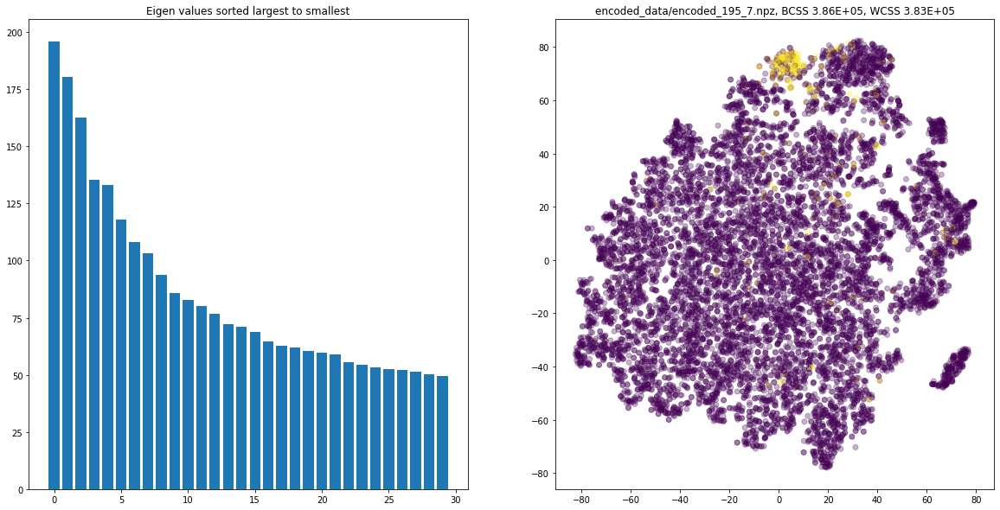

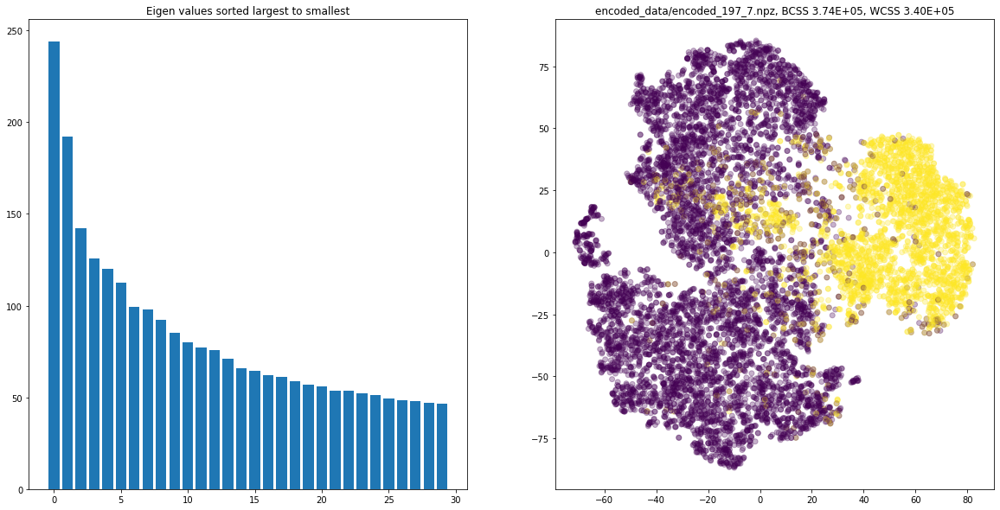

In [16]:
for file in sorted(glob.glob("encoded_data/*_[17].npz")):
    visualize(file)

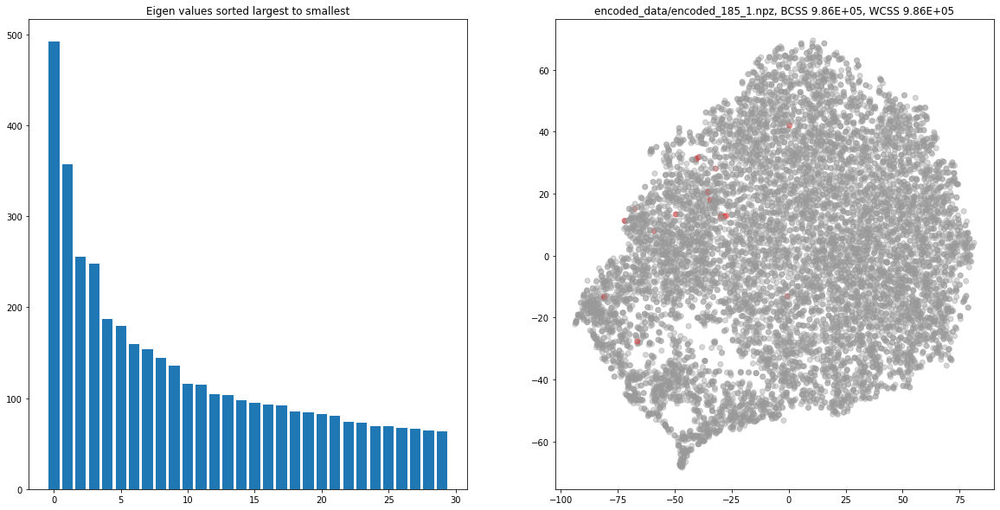

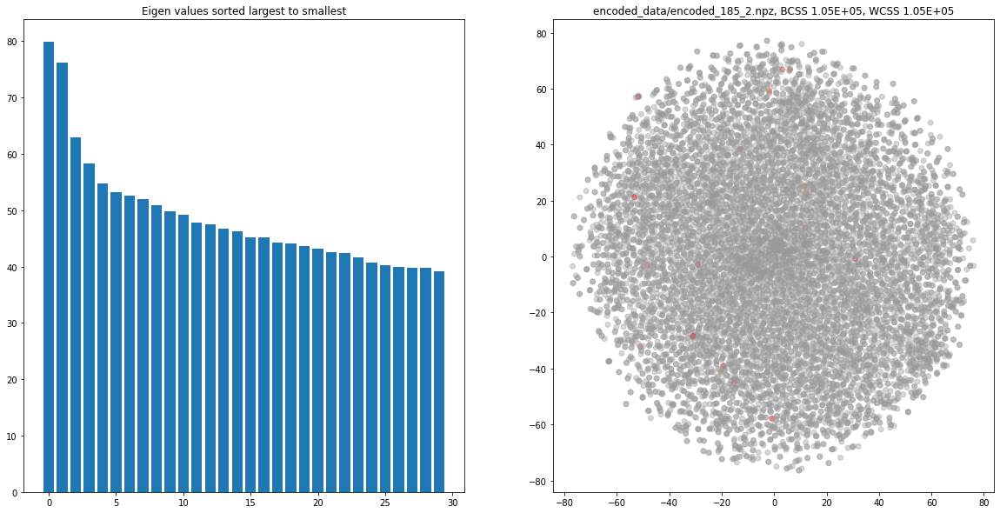

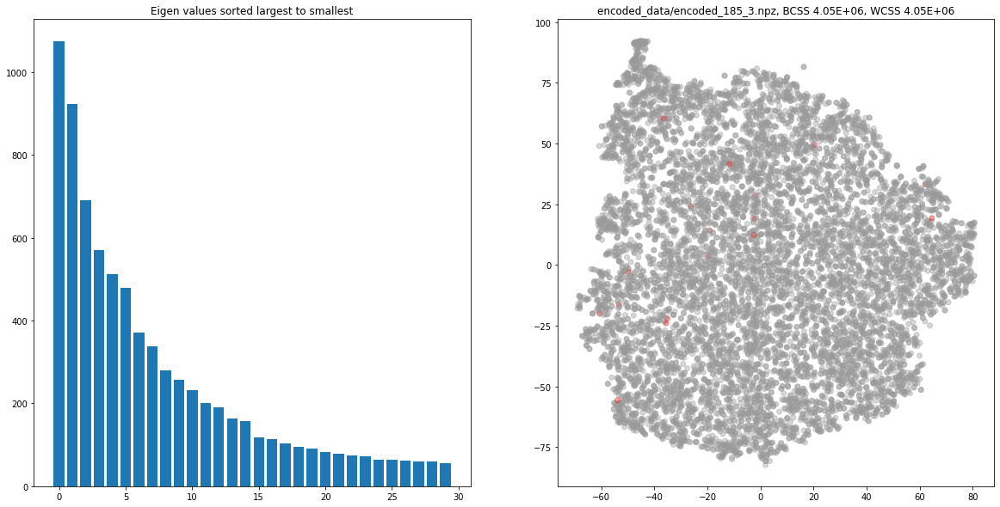

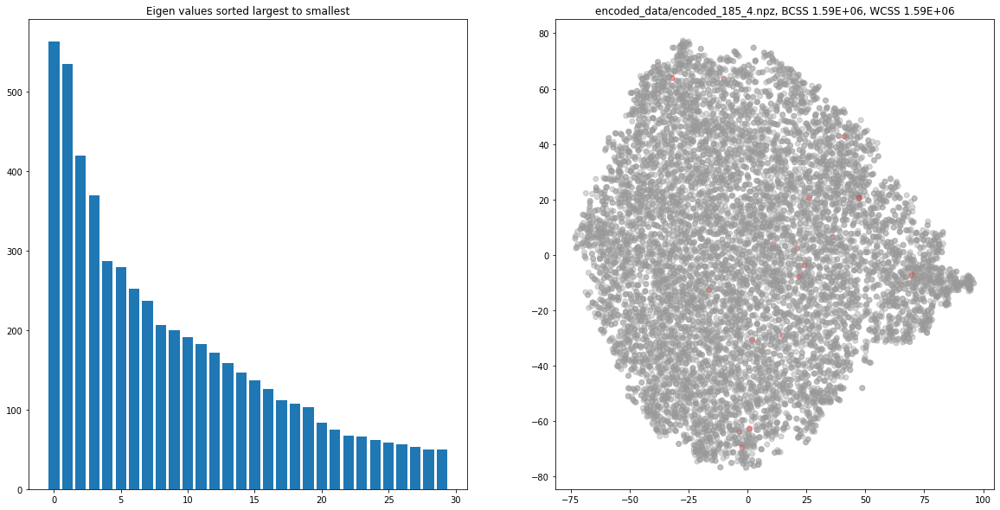

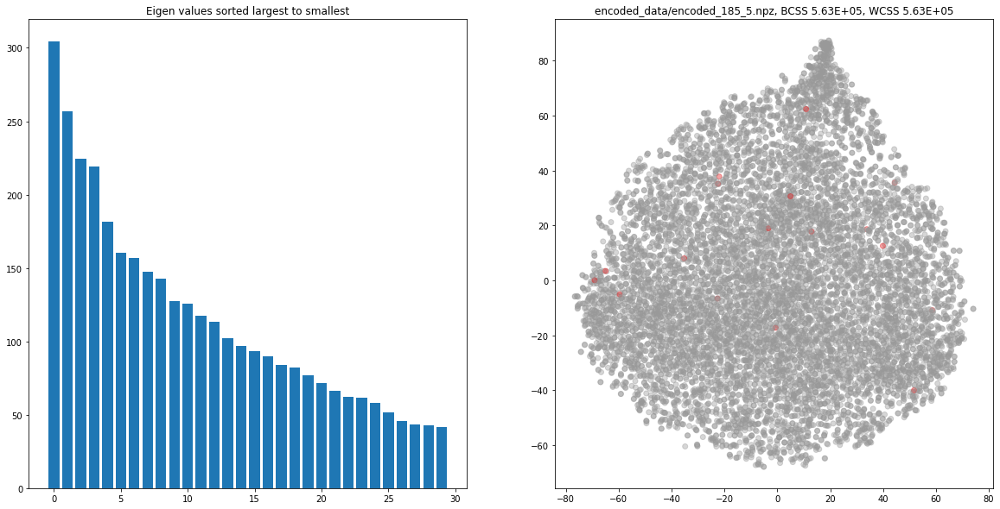

...

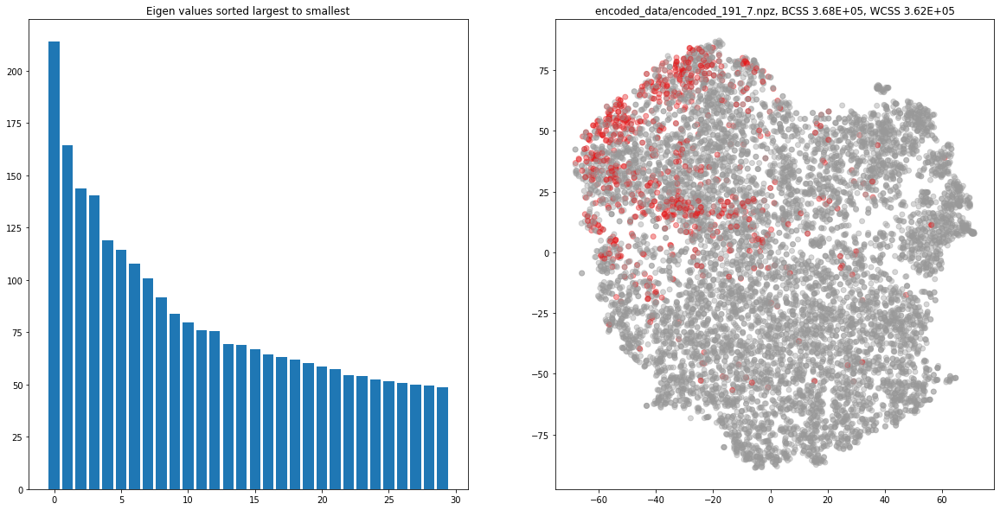

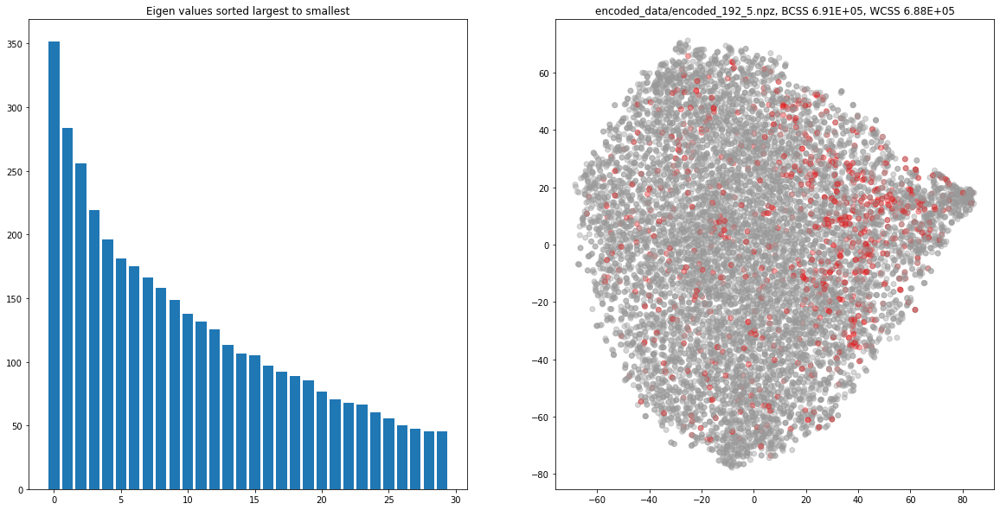

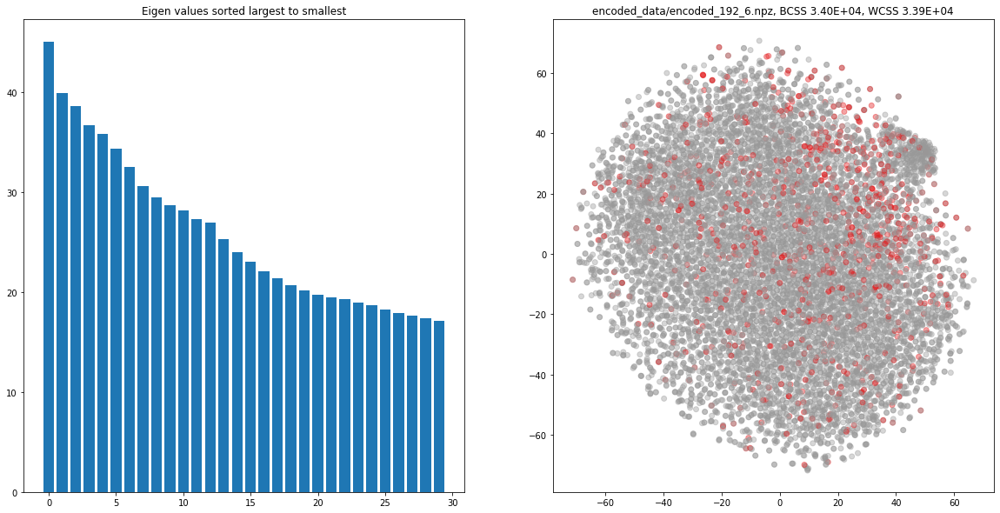

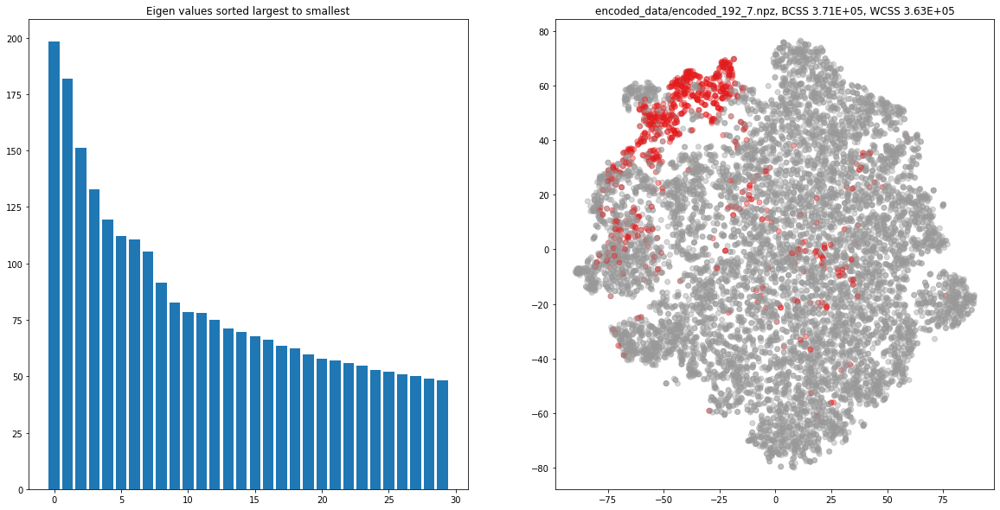

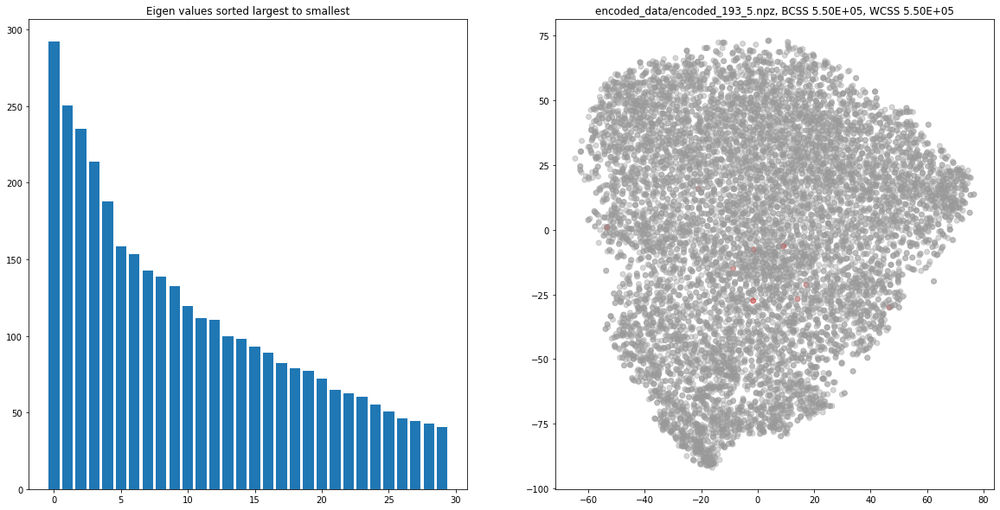

In [ ]:
for file in sorted(glob.glob("encoded_data/*.npz")):
    visualize(file)